In [1]:
from sklearn.datasets import make_classification
import numpy as np
X,y = make_classification(n_samples= 100, n_features=2, n_informative=1, n_redundant=0,
                          n_classes=2, n_clusters_per_class=1, random_state=41, hypercube=False, class_sep=10)

In [2]:
import matplotlib.pyplot as plt 
import seaborn as sns

In [3]:
import pandas as pd

# Dataframe banana taaki table jaisa dikhe
df = pd.DataFrame(X, columns=['Feature_1', 'Feature_2'])
df['Target'] = y

# Pehle 10 rows dekhne ke liye
print(df.head(3))

   Feature_1  Feature_2  Target
0   0.199247  -0.116976       1
1  -0.248820  -0.731152       1
2  -0.354490  -0.708106       1


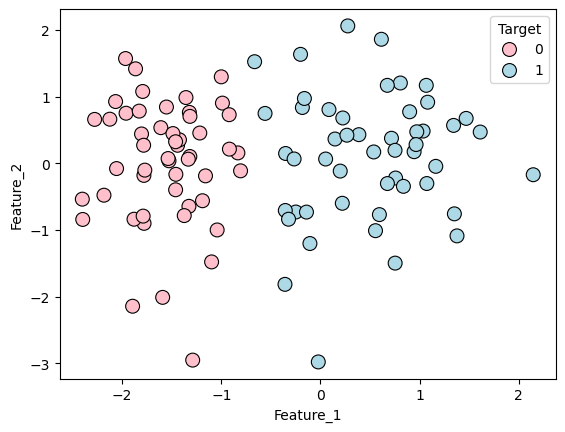

In [4]:
sns.scatterplot(data=df, x='Feature_1', y='Feature_2', hue='Target', 
                palette=['pink', 'lightblue'], edgecolor='black', s=100)
plt.show()

In [5]:
def perceptron(X,y):
    X= np.insert(X,0,1,axis=1)  #bias X mai 0 position pr ek column create kra or usme 1 daal diya 
    weights = np.ones(X.shape[1])#jitne X ki shape hogi utne weights honge  
    lr  = 0.1 # learning rate 
    for i  in range (1000): 
         j= np.random.randint(0,100) # random num select krna 
         y_hat= step(np.dot(X[j], weights))
         weights = weights + lr*(y[j]-y_hat)*X[j]
    return weights[0], weights[1:] # weight ka 0 as intercept and weight ka [1:] coef

In [6]:
 np.dot(np.insert(X[41],0,1),[1,1,1])

np.float64(0.2946000908036749)

In [7]:
def step(z):
    return 1 if z>0 else 0 # agr no positive hai toh it will return 1 else 0 

In [8]:
step(0.29) # predicted if student got placed or not 

1

In [9]:
y[41] # actual me uss student ka placement hua hai ya nhi hua 

np.int64(0)

In [10]:
1+0.1*(0-1)*0.29

0.971

In [11]:
intercept_,coef_ = perceptron(X,y)

In [12]:
print(intercept_)
print(coef_)

0.9
[1.31246698 0.122041  ]


In [13]:
# c=1.0,a=1.34453802,b=0.10749171
# m=-a/b
# c=-c/b

In [14]:
m= -(coef_[0]/coef_[1])
c= -(intercept_/coef_[1])

In [15]:
x_input= np.linspace(-3,3,100) # start,end,samples
y_input= m*x_input + c

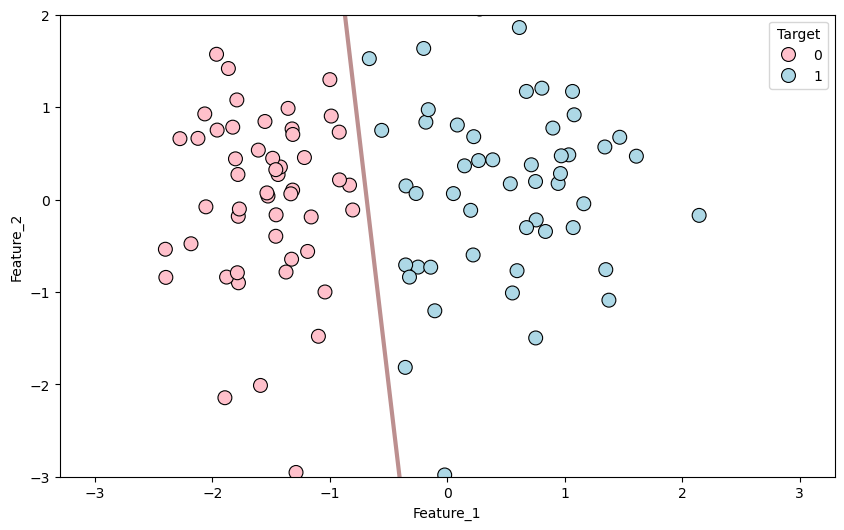

In [16]:
plt.figure(figsize=(10,6))
plt.plot(x_input,y_input,color="#BC8F8F",linewidth=3)
sns.scatterplot(data=df, x='Feature_1', y='Feature_2', hue='Target', 
                palette=['pink', 'lightblue'], edgecolor='black', s=100)
plt.ylim(-3,2)
plt.show()

In [21]:
def perceptron(X,y):
    m=[]
    c=[]
    X = np.insert(X,0,1,axis=1)
    weights= np.ones(X.shape[1])
    lr=0.1

    for i in range(300):
        j=np.random.randint(0,100)
        y_hat = step(np.dot(X[j],weights))
        weights = weights + lr*(y[j] - y_hat)*X[j]

        m.append(-(weights[1]/weights[2]))
        c.append(-(weights[0]/weights[2]))
    return m , c

In [18]:
m,c= perceptron(X,y)

In [20]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

fig, ax = plt.subplots(figsize=(10, 6))
sns.set_theme(style="white")


sns.scatterplot(data=df, x='Feature_1', y='Feature_2', hue='Target', 
                palette=['pink', 'lightblue'], edgecolor='black', s=100, ax=ax)


x_input = np.linspace(-3, 3, 100)
line, = ax.plot([], [], color="#BC8F8F", linewidth=3) 

ax.set_ylim(-3, 2)


def update(i):
    y_curr = m[i] * x_input + c[i]
    line.set_data(x_input, y_curr)
    ax.set_title(f'Epoch {i + 1}') # Title mein epoch dikhayega
    return line,


anim = FuncAnimation(fig, update, frames=len(m), interval=100, blit=True)

# Sabse important step: Animation ko HTML mein convert karna
plt.close() # Ye extra static plot ko dikhne se rokta hai
HTML(anim.to_jshtml())

E:\prerna\Lib\site-packages\matplotlib\animation.py:908: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(
Animation size has reached 21017099 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
